In [25]:
import torch
import os
import pandas as pd
from torch.utils.data import Dataset, DataLoader
import torchvision.models as models
from torchvision  import transforms
import cv2


class ImageDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.transform = transform
        self.image_paths = []
        self.labels = []

        class_names = [
            "arctic fox", "corgi", "electric ray", "goldfish", "hammerhead shark", 
            "horse", "hummingbird", "indigo finch", "puma", "red panda"
        ]

        for label, class_name in enumerate(class_names):
            class_dir = os.path.join(root_dir, class_name)
            for img_name in os.listdir(class_dir):
                img_path = os.path.join(class_dir, img_name)
                self.image_paths.append(img_path)
                self.labels.append(label)

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        image = cv2.imread(img_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        label = self.labels[idx]
        if self.transform:
            image = self.transform(image)
        return image, label
    
batch_size = 64

preprocess = transforms.Compose([
    transforms.ToTensor(), 
    transforms.ConvertImageDtype(torch.float), 
    transforms.Resize((224, 224), antialias=True),   
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

class_names = [
    "arctic fox", "corgi", "electric ray", "goldfish", "hammerhead shark", 
    "horse", "hummingbird", "indigo finch", "puma", "red panda"
]
data_dir = "/home/walke/college/cv/ass2/CV Assignment 2/Q2/network visualization"

dataset = ImageDataset(root_dir=data_dir, transform=preprocess)

train_size = int(0.9 * len(dataset))

val_size = len(dataset) - train_size

train_dataset, val_dataset = torch.utils.data.random_split(dataset, [train_size, val_size])

train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_dataloader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

len(dataset)



50

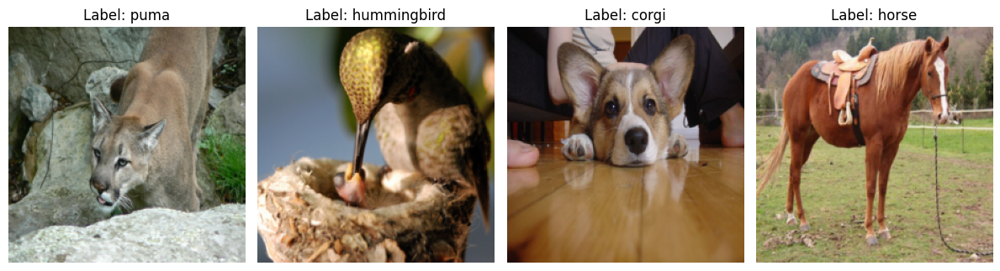

In [26]:
import matplotlib.pyplot as plt
import random
import numpy as np
indices = random.sample(range(len(train_dataset)), 4)
plt.figure(figsize=(12, 6))
for i, idx in enumerate(indices):
    img, label = train_dataset[idx]
    img = img.permute(1, 2, 0).numpy()
    img = img * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406])
    img = np.clip(img, 0, 1)

    plt.subplot(1, 4, i + 1)
    plt.imshow(img)
    plt.title(f"Label: {class_names[label]}")
    plt.axis("off")

plt.tight_layout()
plt.show()

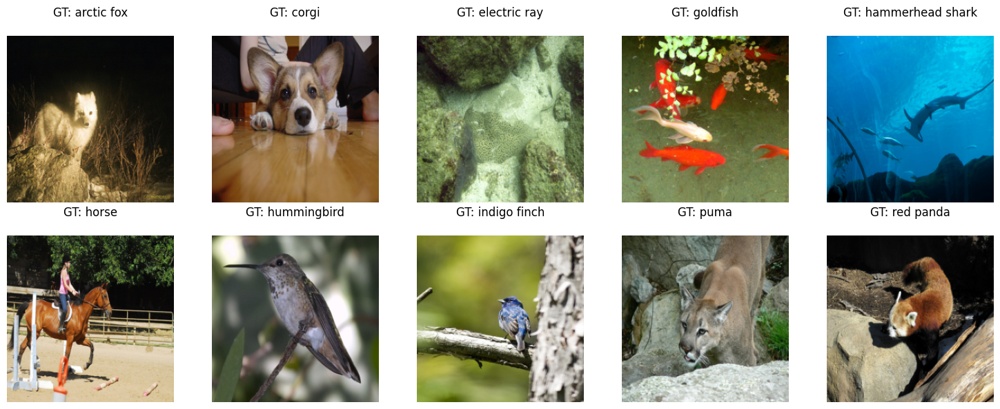

In [27]:

def visualize_images(images_with_labels):
    plt.figure(figsize=(15, 6))
    for i, (img, label) in enumerate(images_with_labels):
        img = img.permute(1, 2, 0).numpy()
        img = img * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406])
        img = np.clip(img, 0, 1)

        plt.subplot(2, 5, i + 1)
        plt.imshow(img)
        ground_truth = class_names[label]
        plt.title(f"GT: {ground_truth}\n")
        plt.axis("off")
    plt.tight_layout()
    plt.show()


selected_images = {}
for idx, (img, label) in enumerate(dataset):
    if label not in selected_images:
        selected_images[label] = (img, label)
    if len(selected_images) == len(class_names):
        break

visualize_images(selected_images.values())

In [28]:
from torchvision.models import resnet18, ResNet18_Weights
device = (
    "cuda"
    if torch.cuda.is_available()
    else "cpu"
)
print(f"Using {device} device")

weights = ResNet18_Weights.DEFAULT
model_trained = resnet18(weights=weights)

for param in model_trained.parameters():
    param.requires_grad = False

model_trained.fc = torch.nn.Linear(model_trained.fc.in_features, 10) 

model_trained.to(device)

Using cuda device


ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

In [29]:
def compute_saliency_map(image, label, model=model_trained, device=device):
    model.eval()
    image = image.unsqueeze(0).to(device).requires_grad_(True)


    logits = model(image)
    score = logits[0, label]


    model.zero_grad()
    score.backward()

    saliency = image.grad.abs().squeeze().max(dim=0)[0].detach().cpu()

    return saliency



Saliency shape for label 0: torch.Size([224, 224])


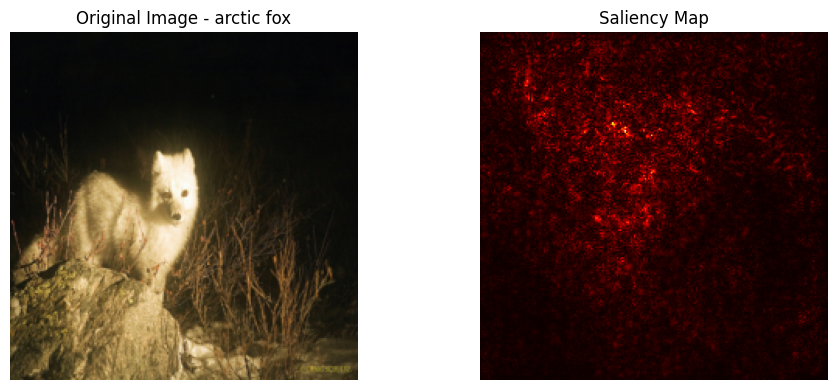

Saliency shape for label 1: torch.Size([224, 224])


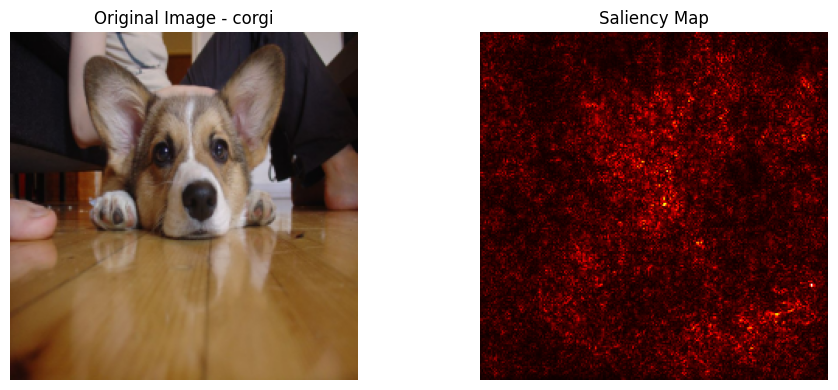

Saliency shape for label 2: torch.Size([224, 224])


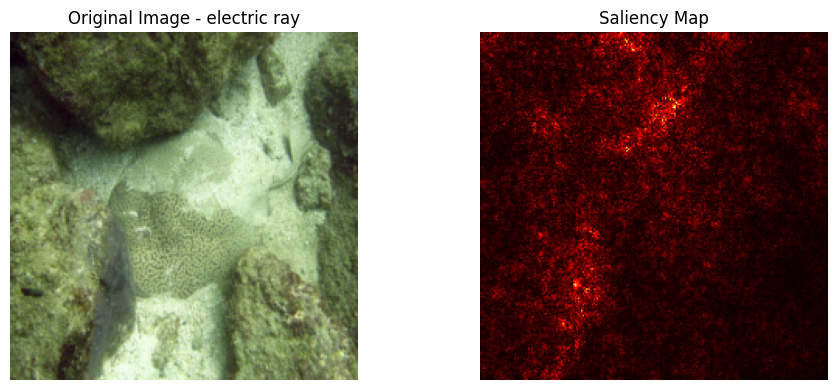

Saliency shape for label 3: torch.Size([224, 224])


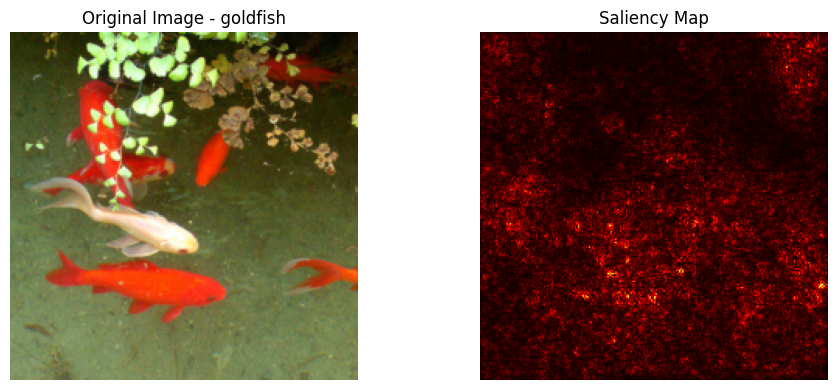

Saliency shape for label 4: torch.Size([224, 224])


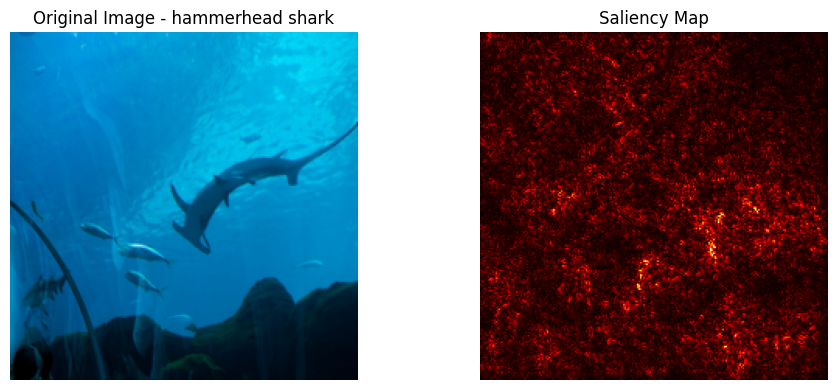

Saliency shape for label 5: torch.Size([224, 224])


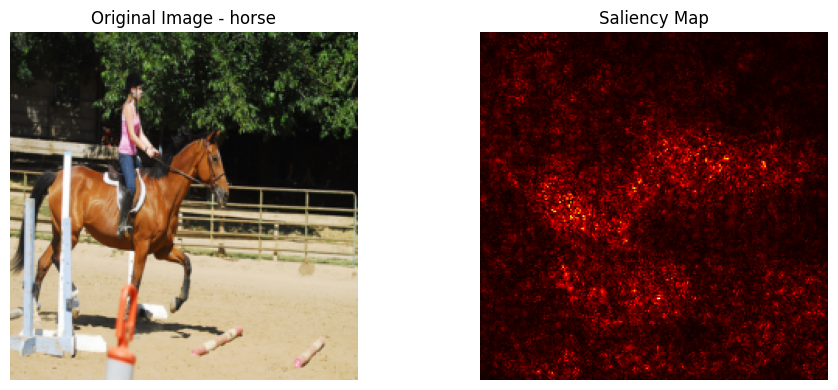

Saliency shape for label 6: torch.Size([224, 224])


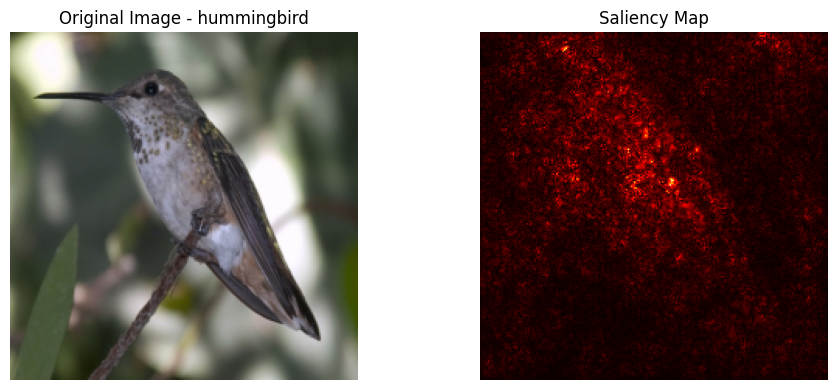

Saliency shape for label 7: torch.Size([224, 224])


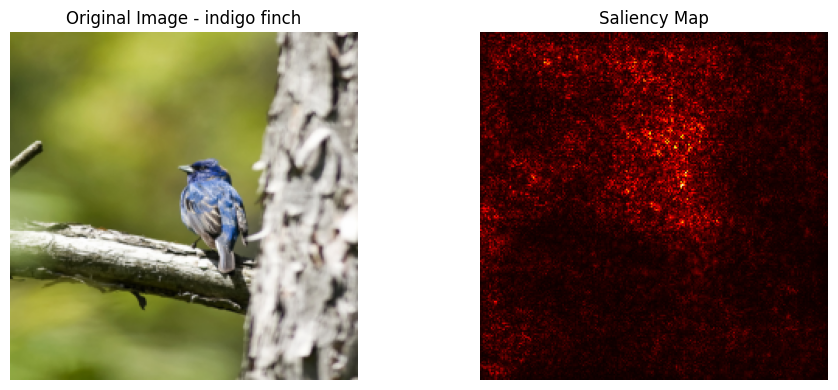

Saliency shape for label 8: torch.Size([224, 224])


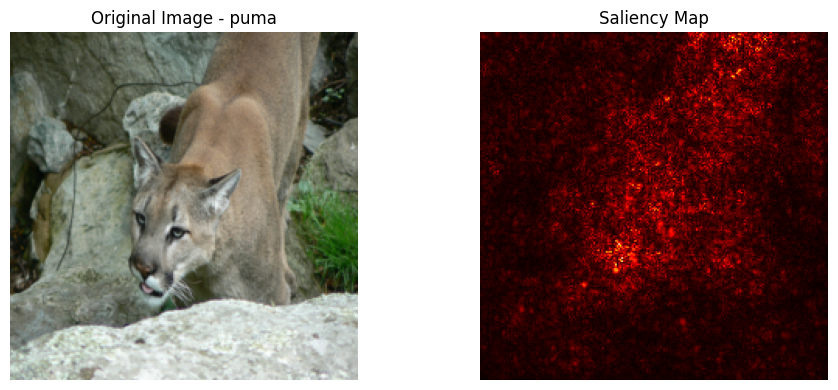

Saliency shape for label 9: torch.Size([224, 224])


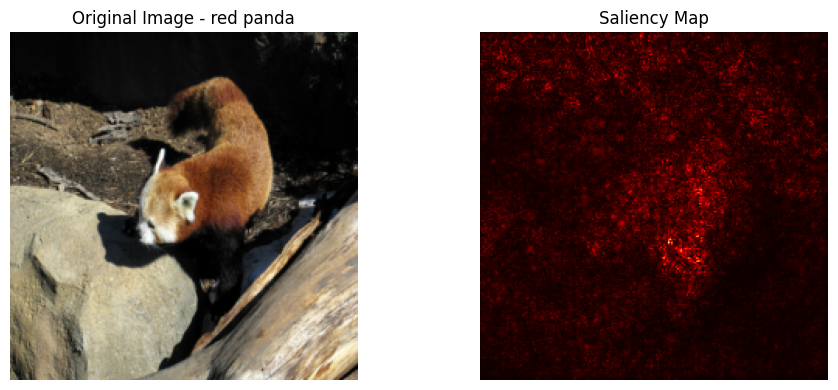

In [30]:
saliency_maps = []


for label, (image, _) in selected_images.items():
    saliency = compute_saliency_map(image, label, model=model_trained, device=device)
    saliency_maps.append(saliency)

    print(f"Saliency shape for label {label}: {saliency.shape}")

    img = image.permute(1, 2, 0).cpu().numpy()
    img = img * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406])
    img = (img * 255).clip(0, 255).astype('uint8')
    
    plt.figure(figsize=(10, 4))
    plt.subplot(1, 2, 1)
    plt.imshow(img)
    plt.title(f"Original Image - {class_names[label]}")
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(saliency, cmap='hot')
    plt.title("Saliency Map")
    plt.axis('off')

    plt.tight_layout()
    plt.show()



In [31]:
from tqdm import tqdm

def train_loop(dataloader, model, loss_fn, optimizer):
    total = len(dataloader)
    size = len(dataloader.dataset)
    num_batches = len(dataloader)
    train_loss, correct = 0, 0

    # Set the model to training mode - important for batch normalization and dropout layers
    # Unnecessary in this situation but added for best practices
    model.train()
    for batch, (X, y) in tqdm(enumerate(dataloader),desc="train", total = total):
        # Compute prediction and loss
        optimizer.zero_grad()
        
        X, y = X.to(device).float(), y.to(device)
        pred = model(X)
        loss = loss_fn(pred, y)
        train_loss += loss.item()

        # Backpropagation
        loss.backward()
        optimizer.step()
        

        correct += (pred.argmax(1) == y).type(torch.float).sum().item()


        if batch % 100 == 0:
            loss, current = loss.item(), batch * batch_size + len(X)


    train_loss /= num_batches
    correct /= size
    print(f"Training Error: \n Accuracy: {(100*correct):>0.1f}%, Avg Training loss: {train_loss:>8f} \n")
    
def test_loop(dataloader, model, loss_fn):
    # Set the model to evaluation mode - important for batch normalization and dropout layers
    # Unnecessary in this situation but added for best practices
    # model.load_state_dict(torch.load(model_path))

    model.eval()
    size = len(dataloader.dataset)
    num_batches = len(dataloader)
    test_loss, correct = 0, 0

    # Evaluating the model with torch.no_grad() ensures that no gradients are computed during test mode
    # also serves to reduce unnecessary gradient computations and memory usage for tensors with requires_grad=True
    with torch.no_grad():
        for X, y in dataloader:
            X, y = X.to(device).float(), y.to(device)
            pred = model(X)
            test_loss += loss_fn(pred, y).item()
            
            # _, y = torch.argmax(y, dim=1)  
            correct += (pred.argmax(1) == y).type(torch.float).sum().item()

    test_loss /= num_batches
    correct /= size
    print(f"Test Error: \n Accuracy: {(100*correct):>0.1f}%, Avg loss: {test_loss:>8f} \n")


def val_loop(dataloader, model, loss_fn):

    model.eval()
    size = len(dataloader.dataset)
    num_batches = len(dataloader)
    val_loss, correct = 0, 0

    with torch.no_grad():
        for X, y in dataloader:
            X, y = X.to(device).float(), y.to(device)
            pred = model(X)
            val_loss += loss_fn(pred, y).item()
            
            # _, y = torch.argmax(y, dim=1)  
            correct += (pred.argmax(1) == y).type(torch.float).sum().item()

    val_loss /= num_batches
    correct /= size
    print(f"Validation Error: \n Accuracy: {(100*correct):>0.1f}%, Avg Validation loss: {val_loss:>8f} \n")

    return correct

In [32]:

learning_rate = 1e-3
batch_size = 16
epochs = 10

loss_fn = torch.nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model_trained.parameters(), lr=learning_rate)

val_accuracy_highest = 0
val_accuracy_curr = 0

for t in range(epochs):
    print(f"Epoch {t+1}\n-------------------------------")
    train_loop(train_dataloader, model_trained, loss_fn, optimizer)
    val_accuracy_curr = val_loop(val_dataloader, model_trained, loss_fn)
print("Done!")


Epoch 1
-------------------------------


train:   0%|          | 0/1 [00:00<?, ?it/s]

train: 100%|██████████| 1/1 [00:00<00:00,  1.64it/s]


Training Error: 
 Accuracy: 13.3%, Avg Training loss: 2.511737 

Validation Error: 
 Accuracy: 40.0%, Avg Validation loss: 2.262974 

Epoch 2
-------------------------------


train: 100%|██████████| 1/1 [00:00<00:00,  1.72it/s]


Training Error: 
 Accuracy: 8.9%, Avg Training loss: 2.264560 

Validation Error: 
 Accuracy: 40.0%, Avg Validation loss: 2.064277 

Epoch 3
-------------------------------


train: 100%|██████████| 1/1 [00:00<00:00,  1.78it/s]


Training Error: 
 Accuracy: 31.1%, Avg Training loss: 2.061147 

Validation Error: 
 Accuracy: 60.0%, Avg Validation loss: 1.897766 

Epoch 4
-------------------------------


train: 100%|██████████| 1/1 [00:00<00:00,  1.72it/s]


Training Error: 
 Accuracy: 44.4%, Avg Training loss: 1.881351 

Validation Error: 
 Accuracy: 60.0%, Avg Validation loss: 1.748471 

Epoch 5
-------------------------------


train: 100%|██████████| 1/1 [00:00<00:00,  1.78it/s]


Training Error: 
 Accuracy: 60.0%, Avg Training loss: 1.713584 

Validation Error: 
 Accuracy: 80.0%, Avg Validation loss: 1.608296 

Epoch 6
-------------------------------


train: 100%|██████████| 1/1 [00:00<00:00,  1.82it/s]


Training Error: 
 Accuracy: 71.1%, Avg Training loss: 1.552915 

Validation Error: 
 Accuracy: 80.0%, Avg Validation loss: 1.476089 

Epoch 7
-------------------------------


train: 100%|██████████| 1/1 [00:00<00:00,  1.75it/s]


Training Error: 
 Accuracy: 84.4%, Avg Training loss: 1.398522 

Validation Error: 
 Accuracy: 80.0%, Avg Validation loss: 1.354311 

Epoch 8
-------------------------------


train: 100%|██████████| 1/1 [00:00<00:00,  1.80it/s]


Training Error: 
 Accuracy: 86.7%, Avg Training loss: 1.251379 

Validation Error: 
 Accuracy: 80.0%, Avg Validation loss: 1.243385 

Epoch 9
-------------------------------


train: 100%|██████████| 1/1 [00:00<00:00,  1.98it/s]


Training Error: 
 Accuracy: 93.3%, Avg Training loss: 1.113183 

Validation Error: 
 Accuracy: 80.0%, Avg Validation loss: 1.143668 

Epoch 10
-------------------------------


train: 100%|██████████| 1/1 [00:00<00:00,  1.92it/s]

Training Error: 
 Accuracy: 95.6%, Avg Training loss: 0.985396 

Validation Error: 
 Accuracy: 100.0%, Avg Validation loss: 1.056300 

Done!


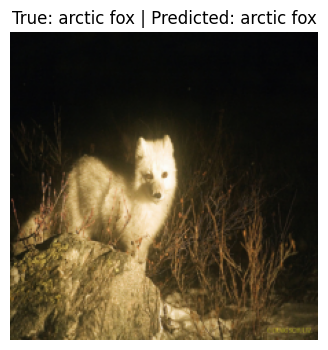

Class Probabilities: [0.49428153 0.04997592 0.03947747 0.09803493 0.04684187 0.04143763
 0.03331645 0.02351573 0.09146263 0.08165593]


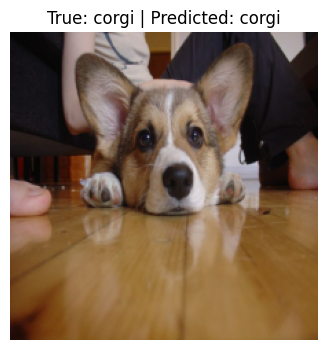

Class Probabilities: [0.03320903 0.44128153 0.05142964 0.137618   0.02082945 0.04765958
 0.02921849 0.01392784 0.11719391 0.1076326 ]


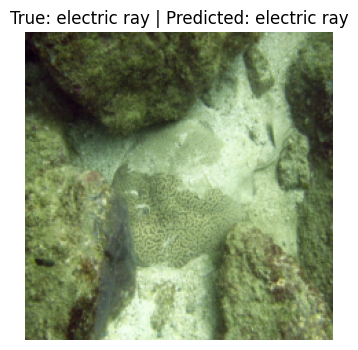

Class Probabilities: [0.07626552 0.05700891 0.41390777 0.09861822 0.06010126 0.05774373
 0.08491985 0.0292879  0.06706027 0.05508658]


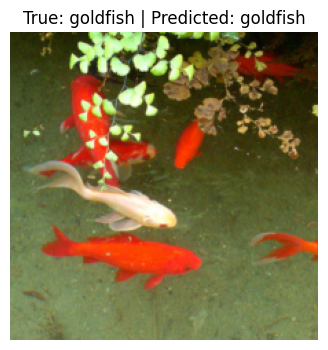

Class Probabilities: [0.0264806  0.03121159 0.04708601 0.6359261  0.06911246 0.0264208
 0.07996936 0.02236853 0.02574467 0.03567986]


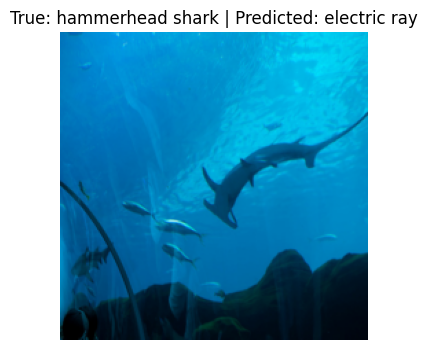

Class Probabilities: [0.12106302 0.03435993 0.27246344 0.08664295 0.1867561  0.06281736
 0.05379549 0.03699913 0.11105587 0.03404674]


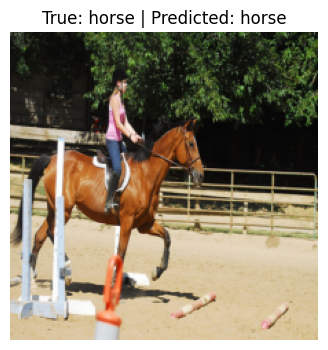

Class Probabilities: [0.04577972 0.03556396 0.02041321 0.09149318 0.03679443 0.5848103
 0.08077747 0.04208791 0.03587576 0.02640407]


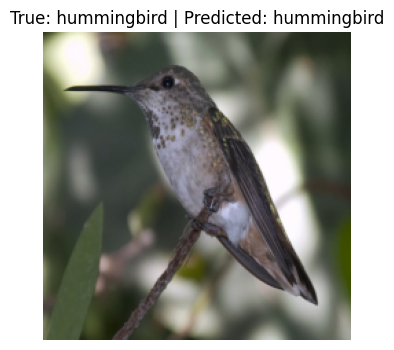

Class Probabilities: [0.05122571 0.08202279 0.1291192  0.05401365 0.07300057 0.07805329
 0.35385922 0.07426536 0.05091467 0.05352549]


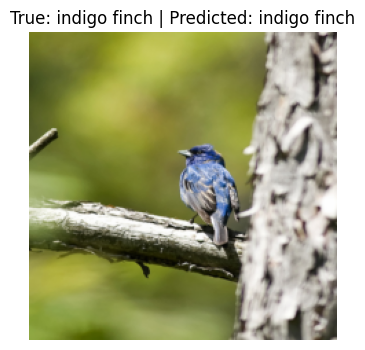

Class Probabilities: [0.03962079 0.0070564  0.01051112 0.02542888 0.02256689 0.02418439
 0.10927743 0.71248007 0.02151266 0.02736129]


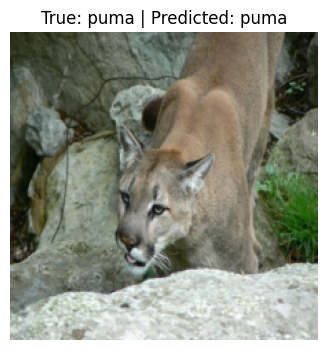

Class Probabilities: [0.10132216 0.05223237 0.0199571  0.03023869 0.03018969 0.06377926
 0.03273137 0.01810515 0.6140098  0.03743447]


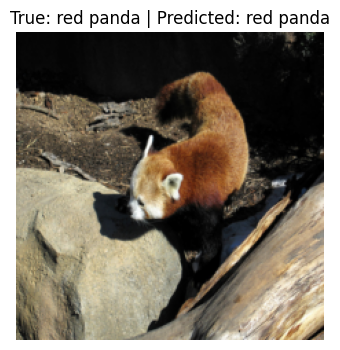

Class Probabilities: [0.08283215 0.07697535 0.06346835 0.04480519 0.07292282 0.07368044
 0.04141107 0.06046626 0.12441847 0.3590199 ]


In [33]:


model_trained.eval()
with torch.no_grad():
    for label, (image, true_label) in selected_images.items():

        image = image.unsqueeze(0).to(device)
        logits = model_trained(image)
        probs = torch.nn.functional.softmax(logits, dim=1)
        predicted_label = torch.argmax(probs, dim=1).item()

        img = image.squeeze(0).permute(1, 2, 0).cpu().numpy()
        img = img * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406])
        img = (img * 255).clip(0, 255).astype('uint8')


        plt.figure(figsize=(6, 4))
        plt.imshow(img)
        plt.title(f"True: {class_names[true_label]} | Predicted: {class_names[predicted_label]}")
        plt.axis('off')
        plt.show()

        print(f"Class Probabilities: {probs.cpu().numpy().flatten()}")




True label: arctic fox
Predicted (Original): arctic fox
Predicted (Constant Mask): corgi
------------------------------------------------------


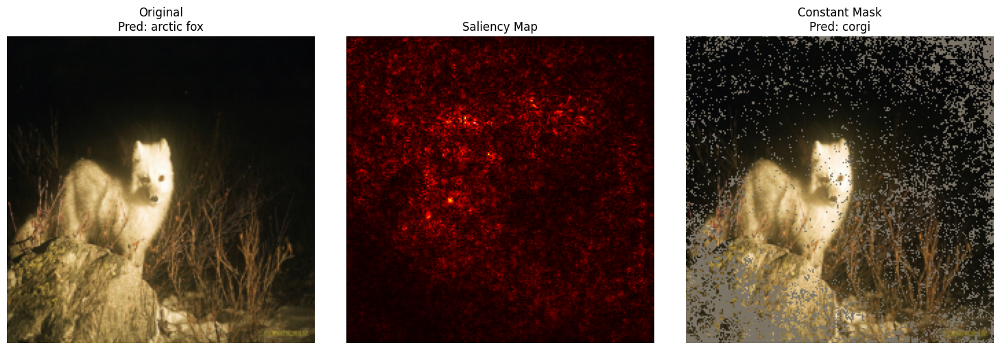

True label: corgi
Predicted (Original): corgi
Predicted (Constant Mask): corgi
------------------------------------------------------


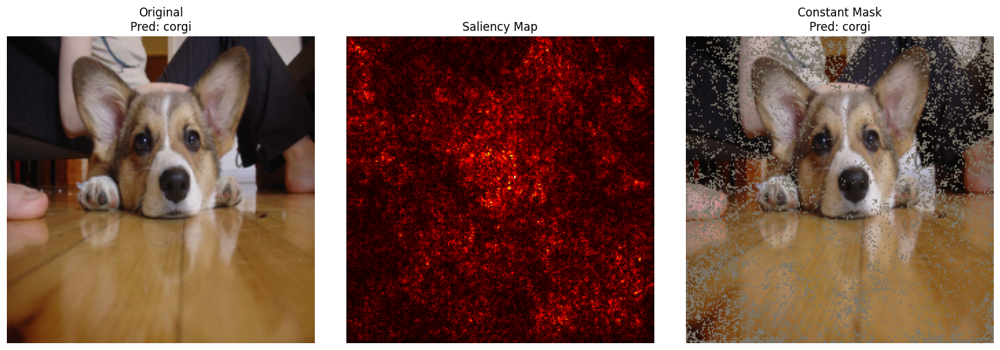

True label: electric ray
Predicted (Original): electric ray
Predicted (Constant Mask): electric ray
------------------------------------------------------


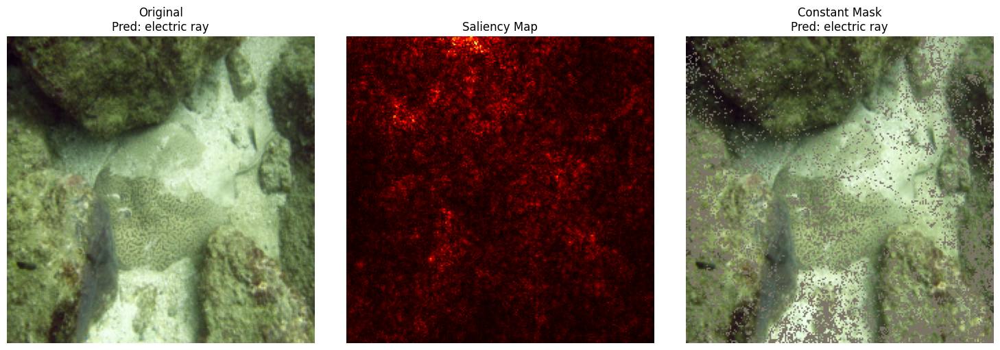

True label: goldfish
Predicted (Original): goldfish
Predicted (Constant Mask): goldfish
------------------------------------------------------


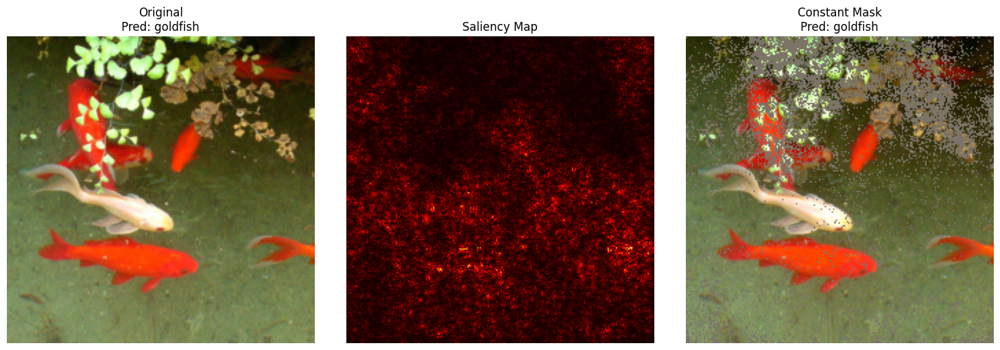

True label: hammerhead shark
Predicted (Original): electric ray
Predicted (Constant Mask): electric ray
------------------------------------------------------


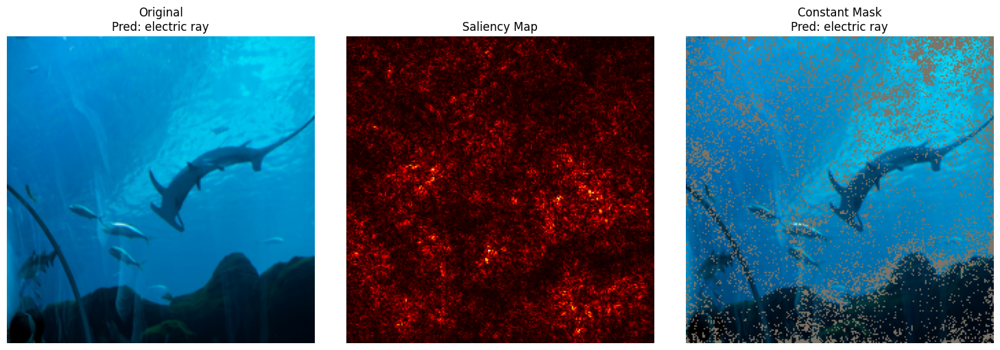

True label: horse
Predicted (Original): horse
Predicted (Constant Mask): horse
------------------------------------------------------


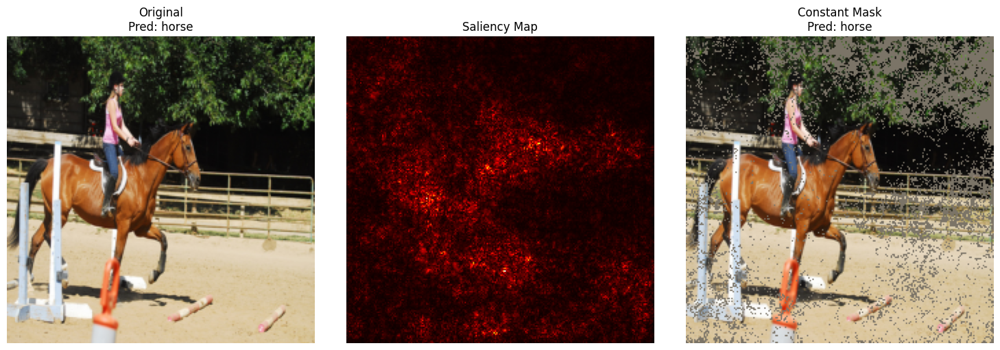

True label: hummingbird
Predicted (Original): hummingbird
Predicted (Constant Mask): electric ray
------------------------------------------------------


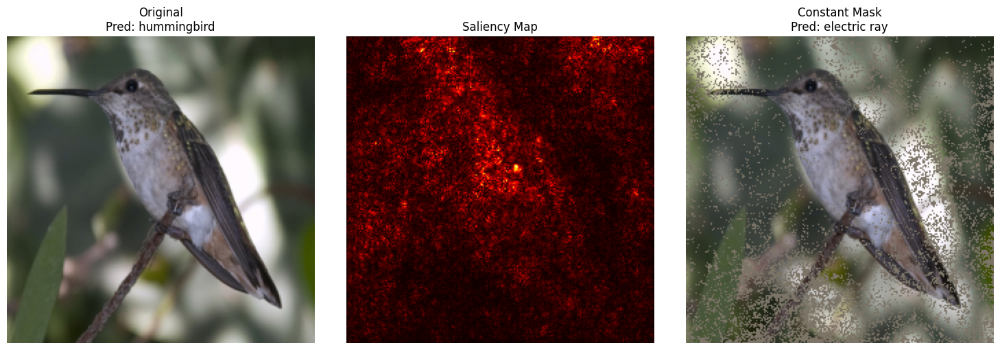

True label: indigo finch
Predicted (Original): indigo finch
Predicted (Constant Mask): indigo finch
------------------------------------------------------


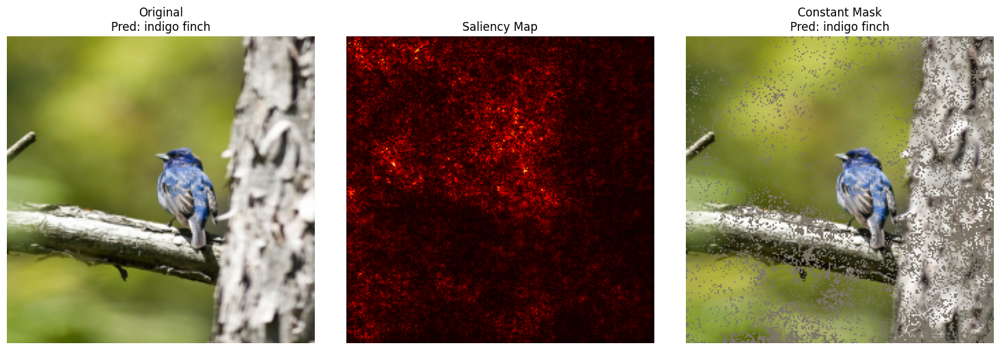

True label: puma
Predicted (Original): puma
Predicted (Constant Mask): puma
------------------------------------------------------


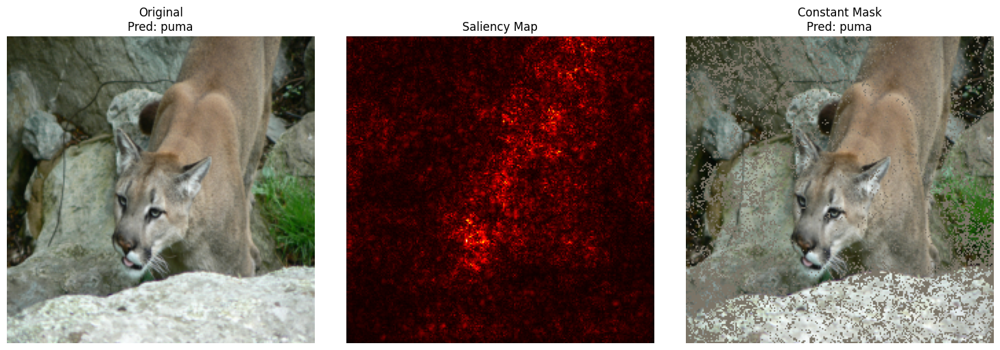

True label: red panda
Predicted (Original): red panda
Predicted (Constant Mask): red panda
------------------------------------------------------


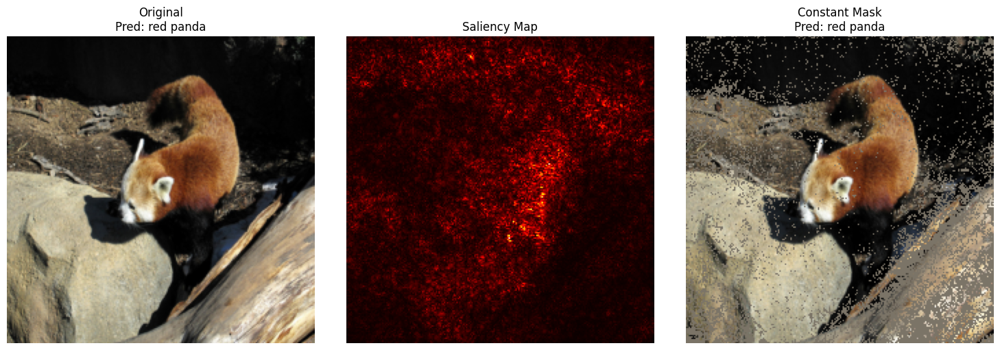

In [34]:


def classify(image, model, device):
    model.eval()
    image_batch = image.unsqueeze(0).to(device)
    with torch.no_grad():
        logits = model(image_batch)
    pred = logits.argmax(dim=1).item()
    return pred



for true_label, (image, label) in selected_images.items():

    saliency = compute_saliency_map(image, label, model=model_trained, device=device)

    saliency_np = saliency.cpu().numpy()
    threshold = np.percentile(saliency_np, 20)
    
    keep_mask = saliency >= threshold  
    masked_image = image.clone()

    saliency_masked = compute_saliency_map(masked_image, label, model=model_trained, device=device)
    saliency_masked_np = saliency_masked.cpu().numpy()
    
    for c in range(masked_image.shape[0]):
            masked_image[c][~keep_mask] = 0.0

    pred_orig = classify(image, model_trained, device)
    pred_const = classify(masked_image, model_trained, device)

    print(f"True label: {class_names[label]}")
    print(f"Predicted (Original): {class_names[pred_orig]}")
    print(f"Predicted (Constant Mask): {class_names[pred_const]}")
    print("------------------------------------------------------")

    image = image.clone().cpu().numpy().transpose(1, 2, 0)
    image = image * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406])  
    image = np.clip(image, 0, 1)

    masked_image = masked_image.clone().cpu().numpy().transpose(1, 2, 0)
    masked_image = masked_image * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406]) 
    masked_image = np.clip(masked_image, 0, 1)
    
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))
    
    axes[0].imshow(image)
    axes[0].set_title(f"Original\nPred: {class_names[pred_orig]}")
    axes[0].axis('off')

    axes[1].imshow(saliency_masked_np, cmap='hot')
    axes[1].set_title("Saliency Map")
    axes[1].axis('off')
    
    axes[2].imshow(masked_image)
    axes[2].set_title(f"Constant Mask\nPred: {class_names[pred_const]}")
    axes[2].axis('off')
    
    plt.tight_layout()
    plt.show()


True label: arctic fox
Predicted (Original): arctic fox
Predicted (Constant Mask): electric ray
------------------------------------------------------


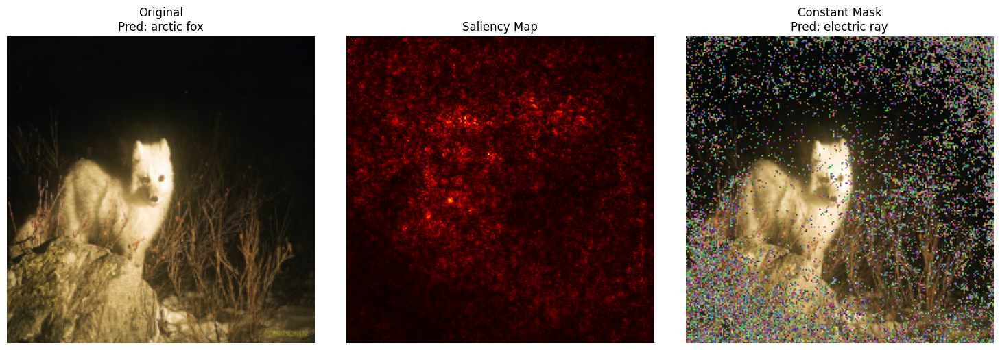

True label: corgi
Predicted (Original): corgi
Predicted (Constant Mask): corgi
------------------------------------------------------


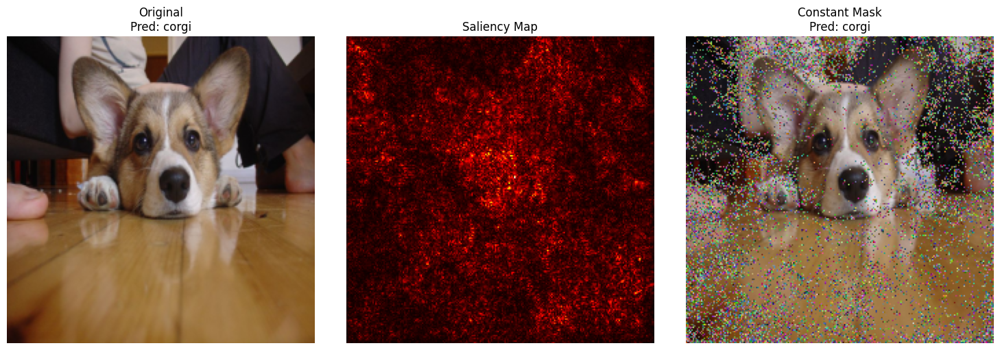

True label: electric ray
Predicted (Original): electric ray
Predicted (Constant Mask): electric ray
------------------------------------------------------


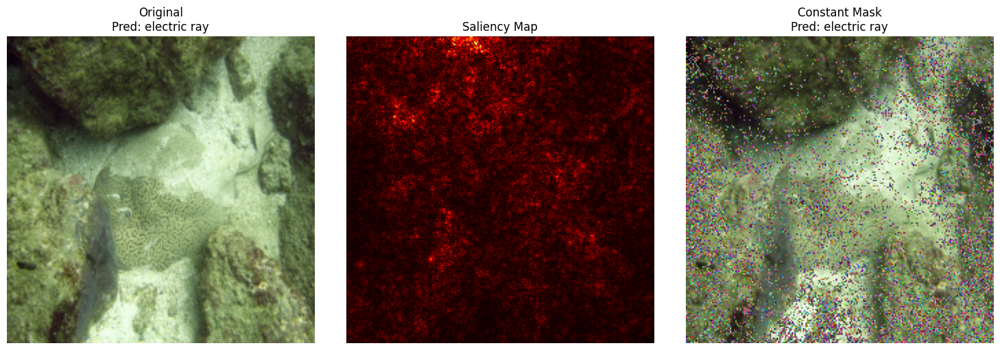

True label: goldfish
Predicted (Original): goldfish
Predicted (Constant Mask): goldfish
------------------------------------------------------


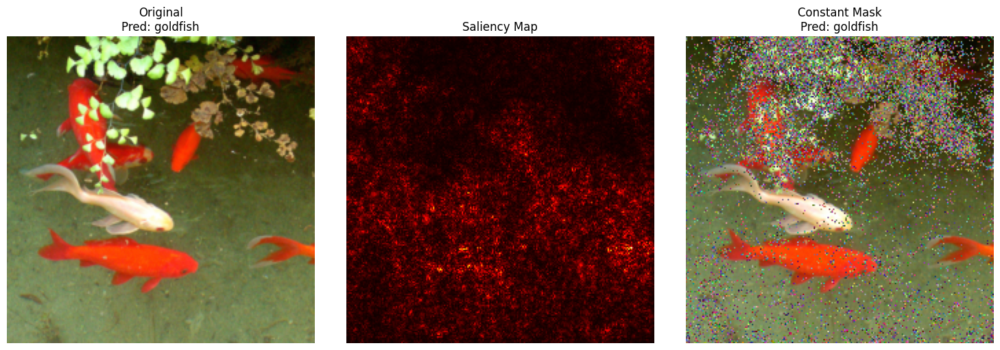

True label: hammerhead shark
Predicted (Original): electric ray
Predicted (Constant Mask): hammerhead shark
------------------------------------------------------


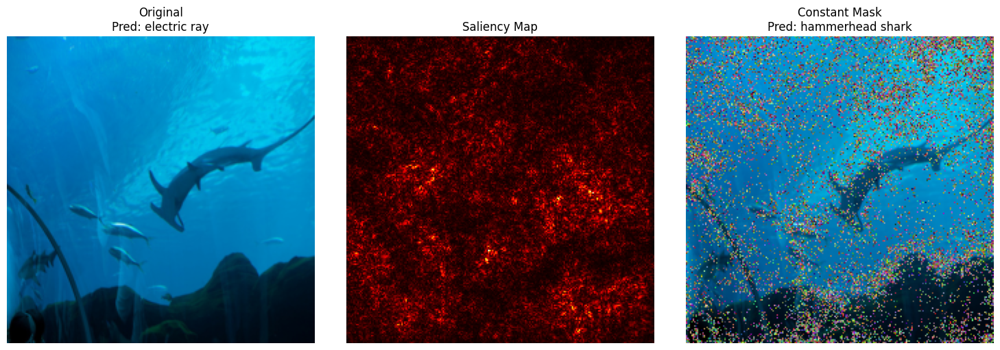

True label: horse
Predicted (Original): horse
Predicted (Constant Mask): horse
------------------------------------------------------


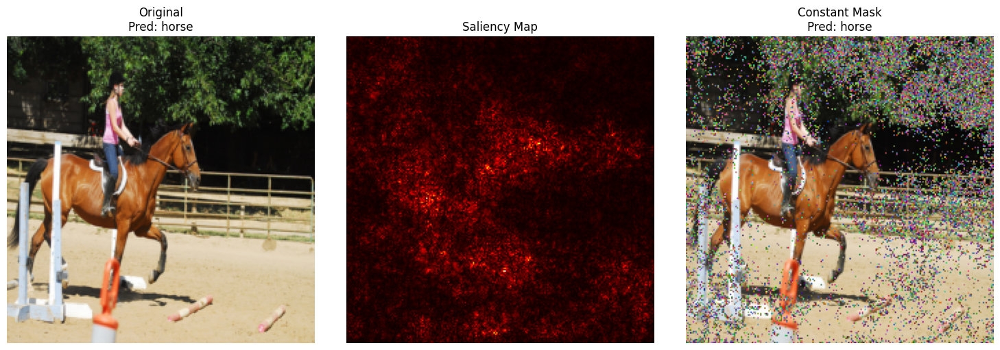

True label: hummingbird
Predicted (Original): hummingbird
Predicted (Constant Mask): electric ray
------------------------------------------------------


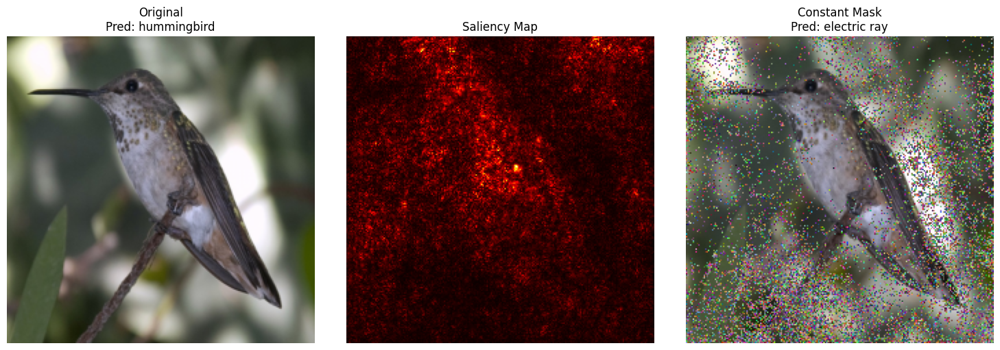

True label: indigo finch
Predicted (Original): indigo finch
Predicted (Constant Mask): indigo finch
------------------------------------------------------


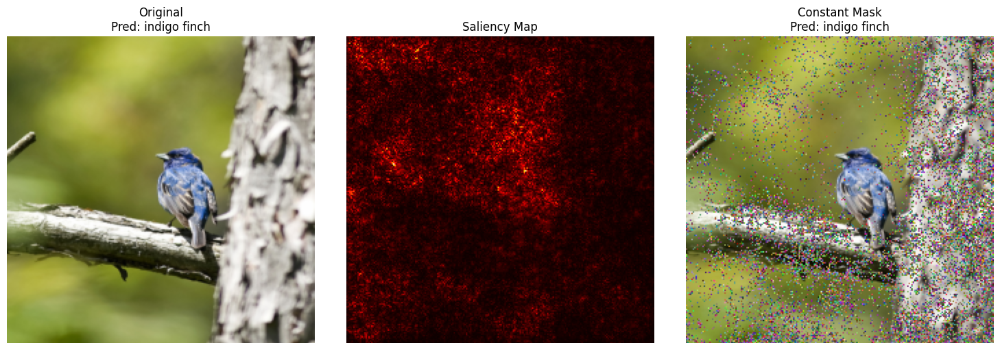

True label: puma
Predicted (Original): puma
Predicted (Constant Mask): puma
------------------------------------------------------


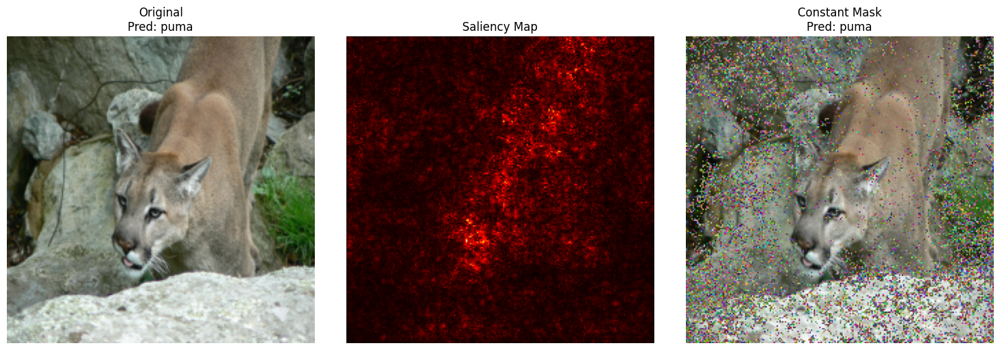

True label: red panda
Predicted (Original): red panda
Predicted (Constant Mask): red panda
------------------------------------------------------


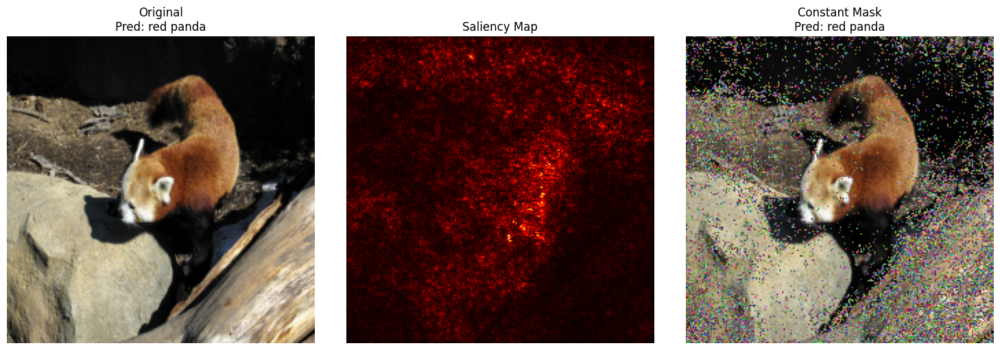

In [35]:

for true_label, (image, label) in selected_images.items():

    saliency = compute_saliency_map(image, label, model=model_trained, device=device)

    saliency_np = saliency.cpu().numpy()
    threshold = np.percentile(saliency_np, 30)
    
    keep_mask = saliency >= threshold  
    masked_image = image.clone()

    saliency_masked = compute_saliency_map(masked_image, label, model=model_trained, device=device)
    saliency_masked_np = saliency_masked.cpu().numpy()
    
    for c in range(masked_image.shape[0]):
        noise = torch.randn_like(masked_image[c])  
        masked_image[c][~keep_mask] = noise[~keep_mask]

    pred_orig = classify(image, model_trained, device)
    pred_const = classify(masked_image, model_trained, device)

    print(f"True label: {class_names[label]}")
    print(f"Predicted (Original): {class_names[pred_orig]}")
    print(f"Predicted (Constant Mask): {class_names[pred_const]}")
    print("------------------------------------------------------")

    image = image.clone().cpu().numpy().transpose(1, 2, 0)
    image = image * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406])  
    image = np.clip(image, 0, 1)

    masked_image = masked_image.clone().cpu().numpy().transpose(1, 2, 0)
    masked_image = masked_image * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406]) 
    masked_image = np.clip(masked_image, 0, 1)
    
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))
    
    axes[0].imshow(image)
    axes[0].set_title(f"Original\nPred: {class_names[pred_orig]}")
    axes[0].axis('off')

    axes[1].imshow(saliency_masked_np, cmap='hot')
    axes[1].set_title("Saliency Map")
    axes[1].axis('off')
    
    axes[2].imshow(masked_image)
    axes[2].set_title(f"Constant Mask\nPred: {class_names[pred_const]}")
    axes[2].axis('off')
    
    plt.tight_layout()
    plt.show()
